# **Oversampling & Data Augmentation**

## **Imports**

In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
import random

## **Parse TFRecord**

In [2]:
def parse_tfr(proto):
    feature_description = {
        'image': tf.io.FixedLenFeature([], tf.string),
        'label': tf.io.FixedLenFeature([], tf.int64),
    }
    rec = tf.io.parse_single_example(proto, feature_description)
    image = tf.image.decode_jpeg(rec['image'], channels=3)
    label = rec['label']
    return image, label

train_file = 'data/preprocessed_train_images.tfrecords'
train_dataset = tf.data.TFRecordDataset(train_file)
train_dataset = train_dataset.map(parse_tfr)

## **Oversample with RO**

In [3]:
# Leere Listen fuer alle Bilder und deren Label
features = []
labels = []

# Extrahieren der Bilder und Label aus dem Trainingsdatensatz 
# gespeichert in Listen
for feature, label in train_dataset:
    # Umwandlung des Mehrdemensionalen Bildverktor in 1-D Vektor
    features.append(tf.reshape(feature, [-1]).numpy()) 
    # Label als Numpy Array umwandeln
    labels.append(label.numpy())

features = np.array(features)
labels = np.array(labels)

# Oversampling mit dem RandomOversampler von Imbalanced-Learn
oversampler = RandomOverSampler(sampling_strategy='auto', random_state=42)
features_resampled, labels_resampled = oversampler.fit_resample(features, labels)

# Neue Beispiele extrahieren um diese anzureichern
added_features = features_resampled[len(features):] 
added_labels = labels_resampled[len(labels):]        
added_dataset = tf.data.Dataset.from_tensor_slices((added_features, added_labels))

In [4]:
print(features_resampled[1])

[104 144  73 ... 100 153  73]


## **Data Augmentation on added Data**

In [5]:
def augment_image(image, label):
    original_shape = (300, 300, 3)
    image = tf.reshape(image, original_shape)

    # Zufaellige Drehung und Anpassung der Helligkeit
    random_flip = random.randint(0, 100) < 50
    random_brightness = random.uniform(-0.2, -0.1) if random_flip else random.uniform(0.1, 0.2)

    if random_flip:
        random_number = random.randint(0, 100)
        if random_number < 33:
            image = tf.image.flip_left_right(image)
        elif random_number < 66:
            image = tf.image.flip_up_down(image)
        else:
            image = tf.image.flip_left_right(image)
            image = tf.image.flip_up_down(image)

    image = tf.image.adjust_brightness(image, delta=random_brightness)

    image = tf.cast(image, tf.uint8)
    label = tf.cast(label, tf.int64)

    return image, label


augmented_images= []
augmented_labels = []

for image, label in added_dataset:
    with tf.device("/CPU:0"):

        augmented_image, augmented_label = augment_image(image, label)
        augmented_images.append(np.array(augmented_image))
        augmented_labels.append(np.array(augmented_label))

augmented_added_dataset = tf.data.Dataset.from_tensor_slices((augmented_images, augmented_labels))
combined_dataset = train_dataset.concatenate(augmented_added_dataset)
combined_dataset = combined_dataset.shuffle(buffer_size=1000)

## **Create TFRecord File**

In [6]:
def serialize_example(image, label):
    with tf.device("/CPU:0"):
        image = tf.saturate_cast(image, tf.uint8)  
        image = tf.image.convert_image_dtype(image, tf.uint8) 

    feature = {
        'image': tf.train.Feature(
            bytes_list=tf.train.BytesList(value=[tf.io.encode_jpeg(image).numpy()])),
        'label': tf.train.Feature(
            int64_list=tf.train.Int64List(value=[label])),
    }
    example = tf.train.Example(features=tf.train.Features(feature=feature))
    example_bytes = example.SerializeToString()
    return example_bytes


output_train_tfrecord_file = 'data/oversampled_train_images.tfrecords'

with tf.io.TFRecordWriter(output_train_tfrecord_file) as train_writer:
    for img, label in combined_dataset:
        example_bytes = serialize_example(img, label)
        train_writer.write(example_bytes)

## **Oversampled Pictures**

In [7]:
def parse_tfrecord_fn(example):
    feature_description = {
        'image': tf.io.FixedLenFeature([], tf.string),
        'label': tf.io.FixedLenFeature([], tf.int64),
    }
    example = tf.io.parse_single_example(example, feature_description)
    image = tf.image.decode_jpeg(example['image'], channels=3)
    label = example['label']
    return image, label

# TFRecord file path
tfrecord_file = 'data/oversampled_train_images.tfrecords'

# Create a TFRecord dataset
raw_dataset = tf.data.TFRecordDataset(tfrecord_file)

# Parse the dataset
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)

In [8]:
# Define a dictionary to store category counts
category_counts = {}

# Iterate through the dataset and count images for each category
for image, label in parsed_dataset:
    label = int(label.numpy())
    if label in category_counts:
        category_counts[label] += 1
    else:
        category_counts[label] = 1

# Print category counts
for category, count in category_counts.items():
    print(f'Category {category}: {count} images')


Category 1: 1116 images
Category 0: 1116 images
Category 2: 1116 images
Category 3: 1116 images


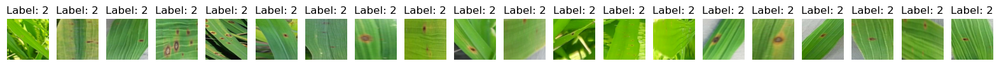

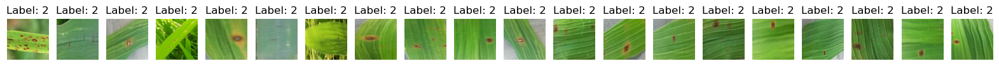

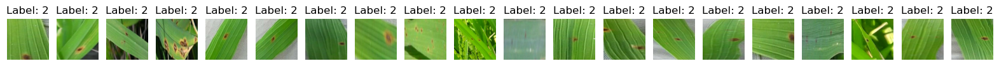

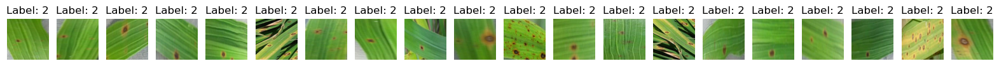

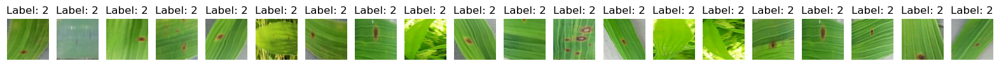

...

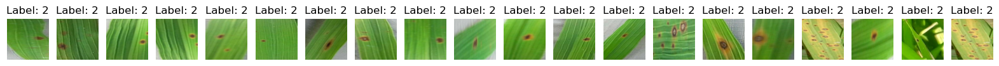

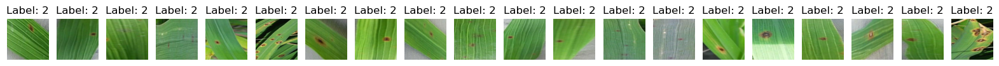

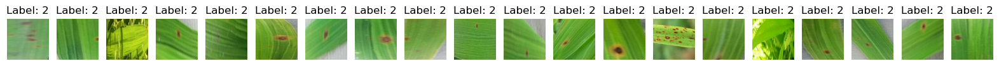

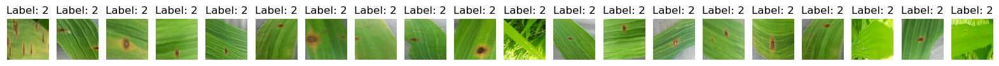

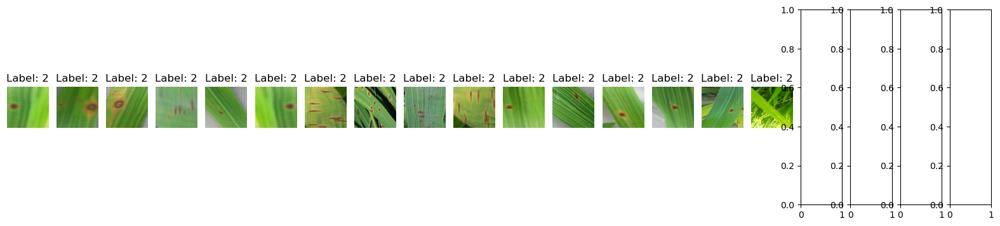

In [9]:
# Filter the dataset to include only examples with label 3
label_to_display = 2
filtered_dataset = parsed_dataset.filter(lambda image, label: label == label_to_display)

# Define the number of images to display in each row
images_per_row = 20

# Create subplots to display the images
fig, axes = plt.subplots(1, images_per_row, figsize=(20, 4))

count = 0
for image, label in filtered_dataset:
    axes[count % images_per_row].imshow(image.numpy())
    axes[count % images_per_row].set_title(f'Label: {label}')
    axes[count % images_per_row].axis('off')
    
    # Create a new row of subplots when needed
    if count % images_per_row == images_per_row - 1:
        plt.show()
        fig, axes = plt.subplots(1, images_per_row, figsize=(20, 4))
    
    count += 1

# Display the remaining images if the total number of images is not a multiple of images_per_row
if count % images_per_row != 0:
    plt.show()


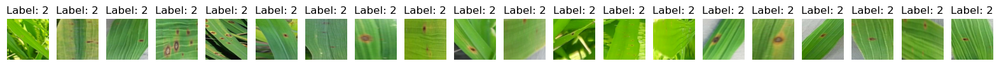

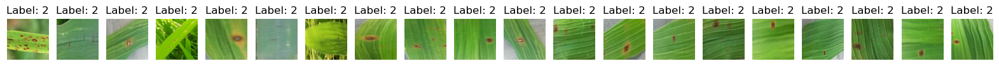

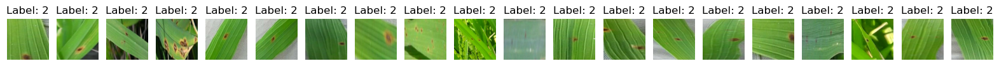

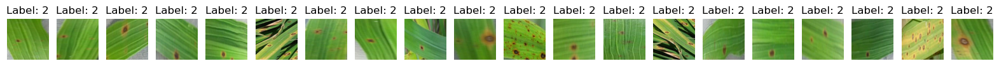

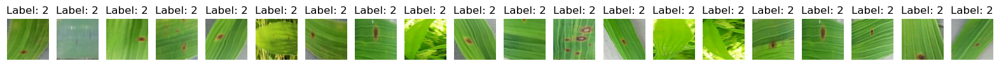

...

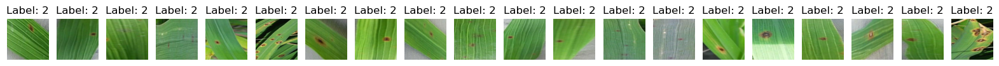

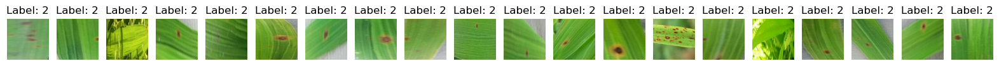

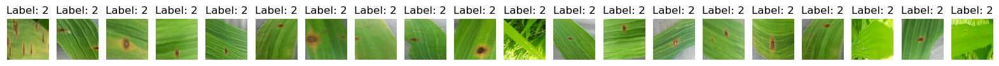

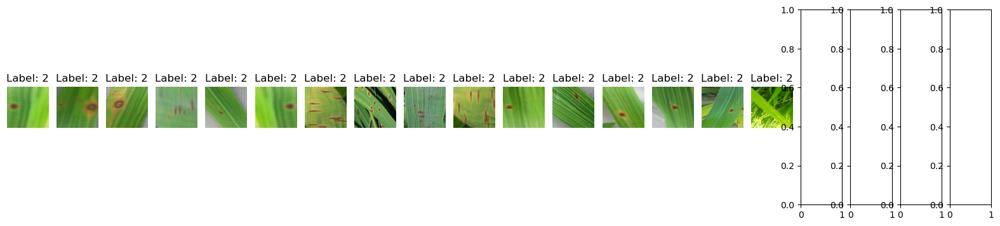

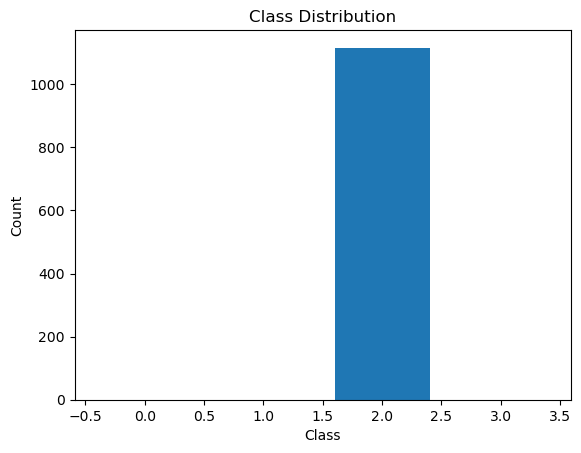

In [10]:
class_counts = {0: 0, 1: 0, 2: 0, 3: 0}  # Modify the class labels as needed

# Create subplots to display the images
fig, axes = plt.subplots(1, images_per_row, figsize=(20, 4))

count = 0
for image, label in filtered_dataset:
    class_counts[label.numpy()] += 1  # Increment the count for the corresponding class
    
    axes[count % images_per_row].imshow(image.numpy())
    axes[count % images_per_row].set_title(f'Label: {label}')
    axes[count % images_per_row].axis('off')
    
    # Create a new row of subplots when needed
    if count % images_per_row == images_per_row - 1:
        plt.show()
        fig, axes = plt.subplots(1, images_per_row, figsize=(20, 4))
    
    count += 1

# Display the remaining images if the total number of images is not a multiple of images_per_row
if count % images_per_row != 0:
    plt.show()

# Display a bar chart of class counts
plt.figure()
plt.bar(class_counts.keys(), class_counts.values())
plt.xlabel('Class')
plt.ylabel('Count')
plt.title('Class Distribution')
plt.show()

### Original

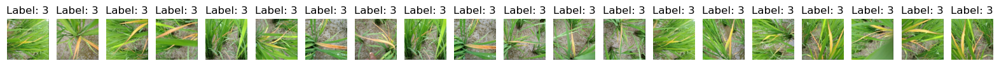

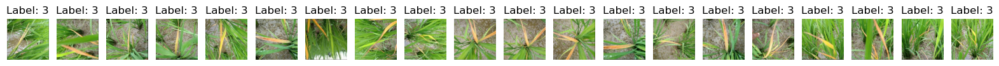

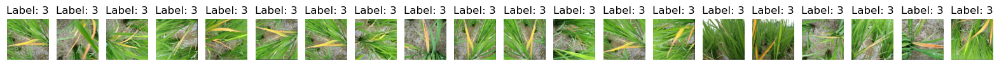

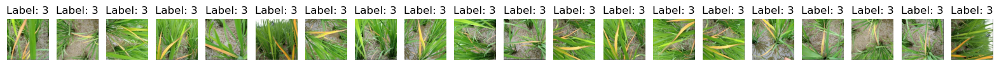

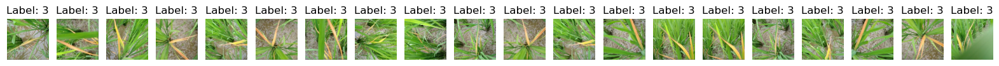

...

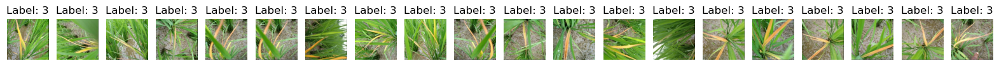

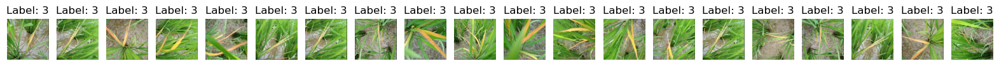

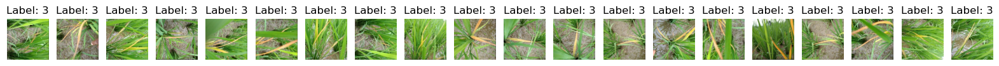

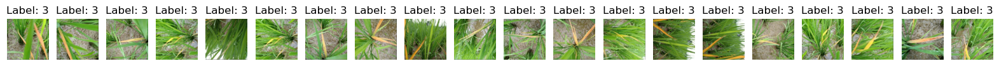

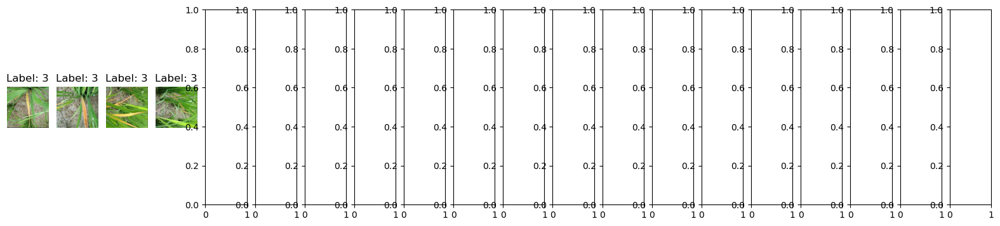

In [11]:
import tensorflow as tf
import matplotlib.pyplot as plt

# Define a function to parse a serialized example
def parse_tfrecord_fn(example):
    feature_description = {
        'image': tf.io.FixedLenFeature([], tf.string),
        'label': tf.io.FixedLenFeature([], tf.int64),
    }
    example = tf.io.parse_single_example(example, feature_description)
    image = tf.image.decode_jpeg(example['image'], channels=3)
    label = example['label']
    return image, label

# TFRecord file path
tfrecord_file = 'data/preprocessed_train_images.tfrecords'

# Create a TFRecord dataset
raw_dataset = tf.data.TFRecordDataset(tfrecord_file)

# Parse the dataset
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)

# Filter the dataset to include only examples with label 3
label_to_display = 3
filtered_dataset = parsed_dataset.filter(lambda image, label: label == label_to_display)

# Define the number of images to display in each row
images_per_row = 20

# Create subplots to display the images
fig, axes = plt.subplots(1, images_per_row, figsize=(20, 4))

count = 0
for image, label in filtered_dataset:
    axes[count % images_per_row].imshow(image.numpy())
    axes[count % images_per_row].set_title(f'Label: {label}')
    axes[count % images_per_row].axis('off')
    
    # Create a new row of subplots when needed
    if count % images_per_row == images_per_row - 1:
        plt.show()
        fig, axes = plt.subplots(1, images_per_row, figsize=(20, 4))
    
    count += 1

# Display the remaining images if the total number of images is not a multiple of images_per_row
if count % images_per_row != 0:
    plt.show()
